100%|██████████| 24/24 [00:58<00:00,  2.43s/it]


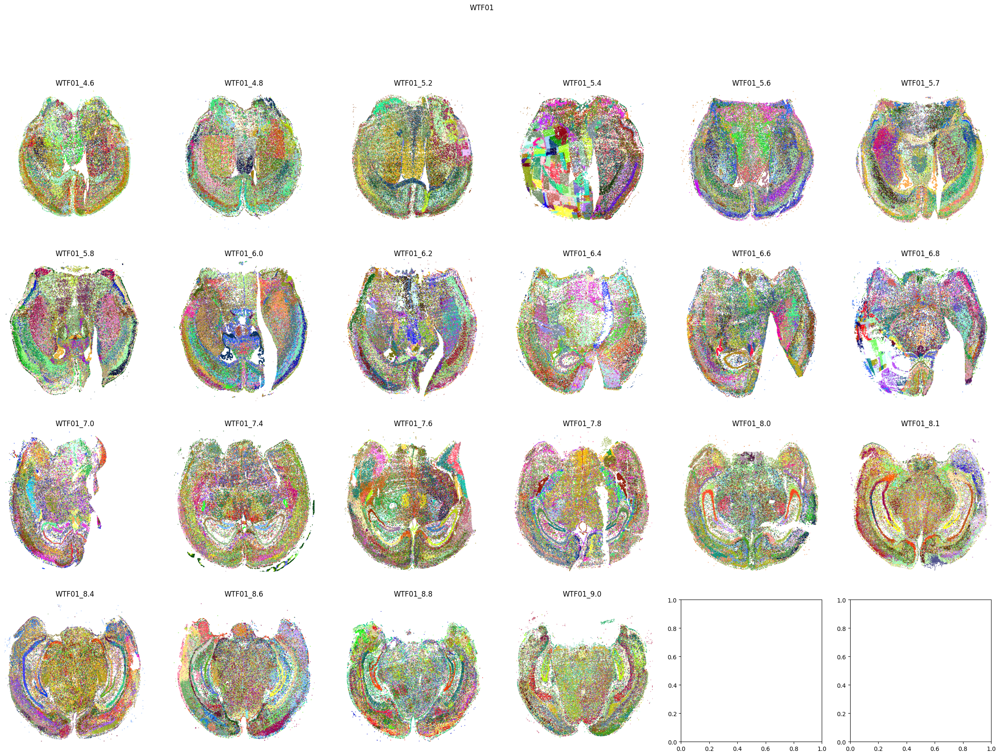

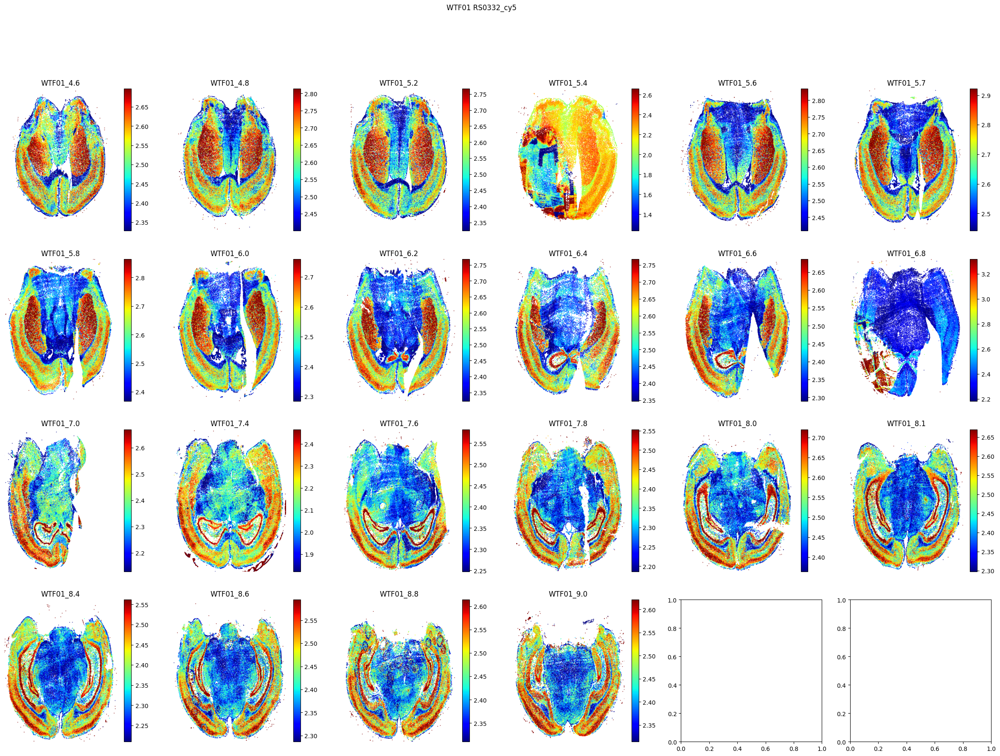

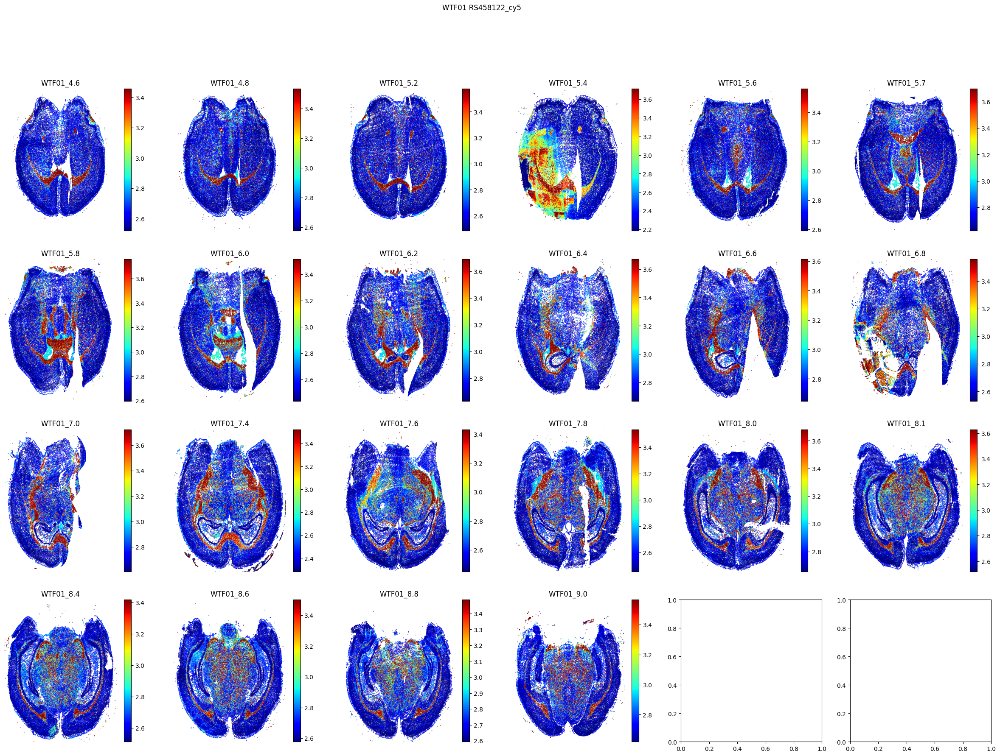

In [2]:
from dredFISH.Registration.Registration import *
from tqdm import tqdm
dataset_path = '/orangedata/Images2024/Zach/MouseBrainAtlas/'
dataset = 'WTF01_1.2.A_2.2.B_3.2.C_4.2.D_5.2.E_6.2.F_2024Apr08'
processing_name = 'Processing_2024Apr19'
registration_name = 'Registration_2024Apr22'
registration_path = os.path.join(dataset_path,dataset,registration_name)
sections = [i for i in os.listdir(os.path.join(dataset_path,dataset,processing_name)) if 'Section' in i]
data_dict = {}
for section in tqdm(sections):
    if section in ['WellC-Section4']:
        continue
    data = fileu.load(os.path.join(dataset_path,dataset,processing_name,section),file_type='anndata')
    if not isinstance(data,type(None)):
        try:
            XYZC  = Registration_Class(data.copy(),registration_path,section,verbose=False).run()
            data.obs['ccf_x'] = XYZC['ccf_x']
            data.obs['ccf_y'] = XYZC['ccf_y']
            data.obs['ccf_z'] = XYZC['ccf_z']
            """ Rename Section """
            section = f"{dataset.split('_')[0]}_{round(data.obs['ccf_x'].mean(),1)}"
            data_dict[section] = data
        except Exception as e:
            print(section)
            print(e)
n_columns = 4
n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
fig.suptitle(f"{dataset.split('_')[0]}")
axs = axs.ravel()
for i,section in enumerate(sorted(list(data_dict.keys()))):
    data = data_dict[section]
    ax = axs[i]
    ax.set_title(section)
    ax.axis('off')
    i+=1
    if not isinstance(data,type(None)):
        ax.scatter(data.obs['ccf_z'],data.obs['ccf_y'],c=data.obs['louvain_colors'],s=0.1)
    ax.set_xlim([-5.5,5.5])
    ax.set_ylim([0,8])
plt.show()

# n_columns = 4
# n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
# fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
# fig.suptitle(f"{dataset.split('_')[0]}")
# axs = axs.ravel()
# for i,section in enumerate(sorted(list(data_dict.keys()))):
#     data = data_dict[section]
#     ax = axs[i]
#     ax.set_title(section)
#     ax.axis('off')
#     i+=1
#     if not isinstance(data,type(None)):
#         ax.scatter(data.obs['stage_x'],data.obs['stage_y'],c=data.obs['louvain_colors'],s=0.1)
# plt.show()

from dredFISH.Utils import basicu
bit = 'RS0332_cy5'
n_columns = 4
n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
fig.suptitle(f"{dataset.split('_')[0]} {bit}")
axs = axs.ravel()
for i,section in enumerate(sorted(list(data_dict.keys()))):
    data = data_dict[section]
    X = data.layers['processed_vectors'].copy()
    X = np.log10(np.clip(X,1,None))
    X = basicu.normalize_fishdata_robust_regression(X)
    c = X[:,data.var.index==bit]
    vmin,vmax = np.percentile(c,[5,95])
    # vmin = 2.4
    # vmax=2.8
    c = np.clip(c,vmin,vmax)
    ax = axs[i]
    ax.set_title(section)
    ax.axis('off')
    im = ax.scatter(data.obs['ccf_z'],data.obs['ccf_y'],c=c,s=0.1,cmap='jet')
    plt.colorbar(im,ax=ax)
    ax.set_xlim([-5.5,5.5])
    ax.set_ylim([0,8])
plt.show()

from dredFISH.Utils import basicu
bit = 'RS458122_cy5'
n_columns = 4
n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
fig.suptitle(f"{dataset.split('_')[0]} {bit}")
axs = axs.ravel()
for i,section in enumerate(sorted(list(data_dict.keys()))):
    data = data_dict[section]
    X = data.layers['processed_vectors'].copy()
    X = np.log10(np.clip(X,1,None))
    X = basicu.normalize_fishdata_robust_regression(X)
    c = X[:,data.var.index==bit]
    vmin,vmax = np.percentile(c,[5,95])
    # vmin = 2.4
    # vmax=2.8
    c = np.clip(c,vmin,vmax)
    ax = axs[i]
    ax.set_title(section)
    ax.axis('off')
    im = ax.scatter(data.obs['ccf_z'],data.obs['ccf_y'],c=c,s=0.1,cmap='jet')
    plt.colorbar(im,ax=ax)
    ax.set_xlim([-5.5,5.5])
    ax.set_ylim([0,8])
plt.show()

100%|██████████| 24/24 [01:30<00:00,  3.78s/it]


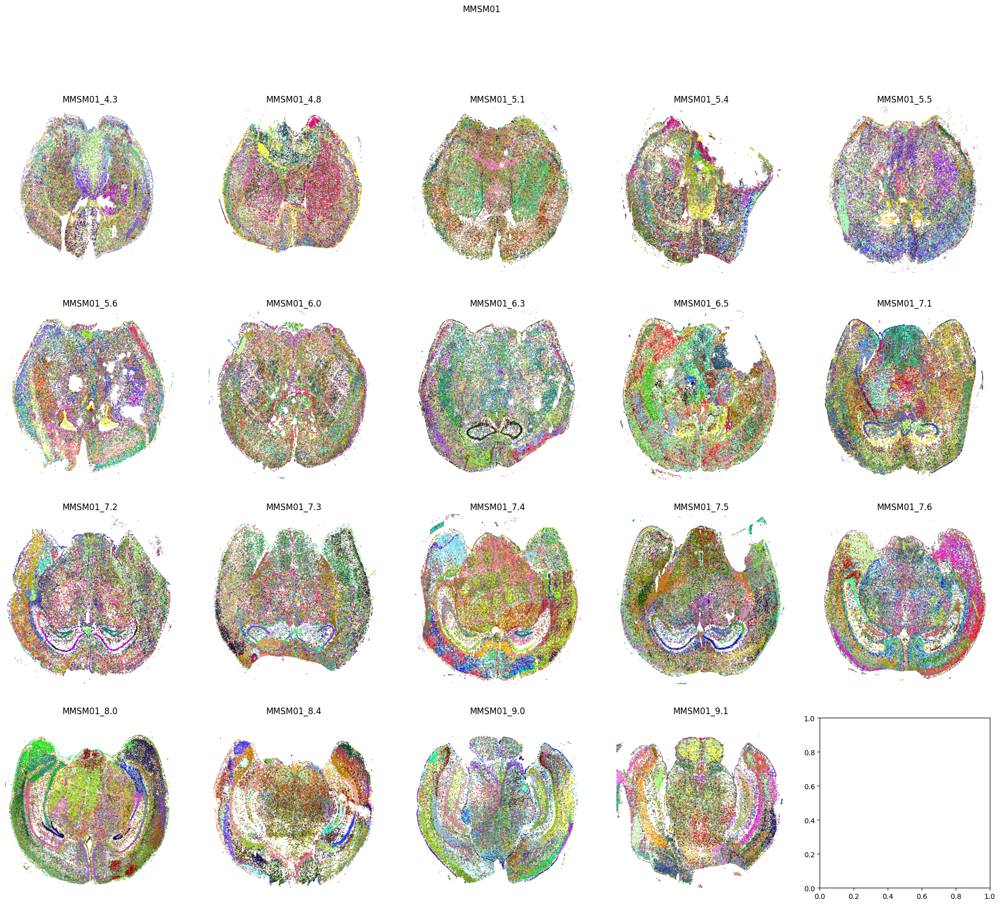

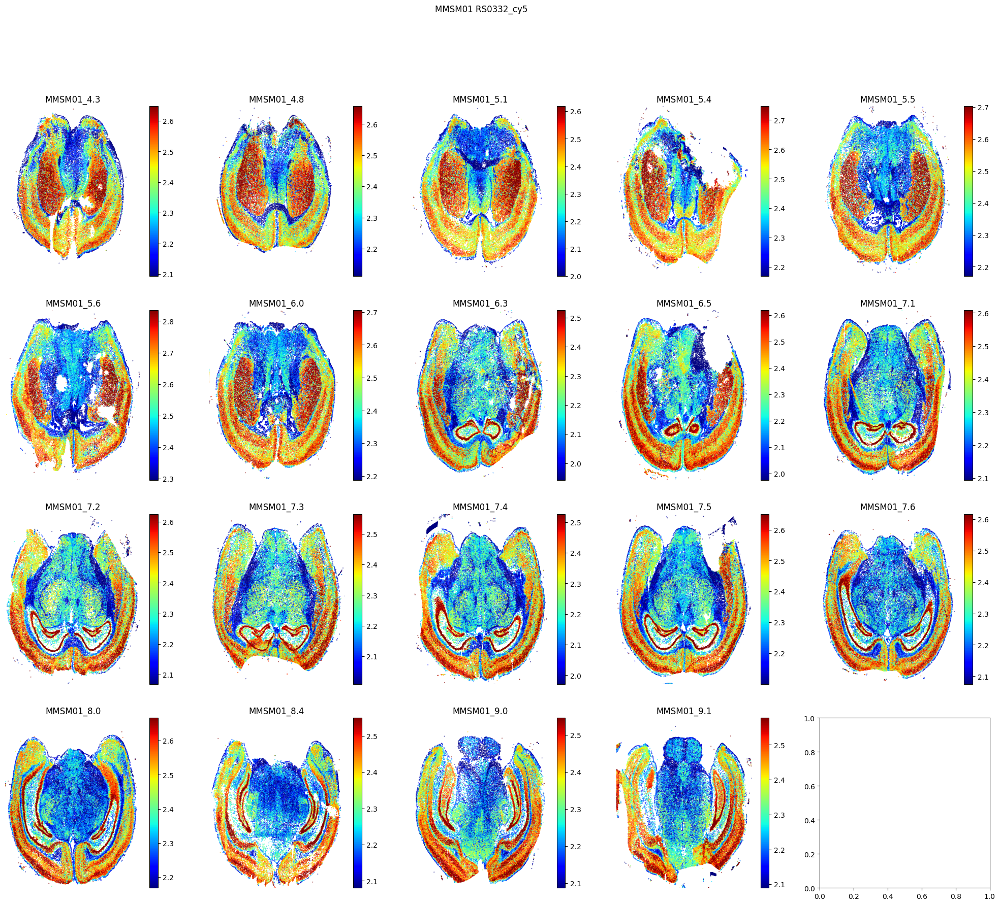

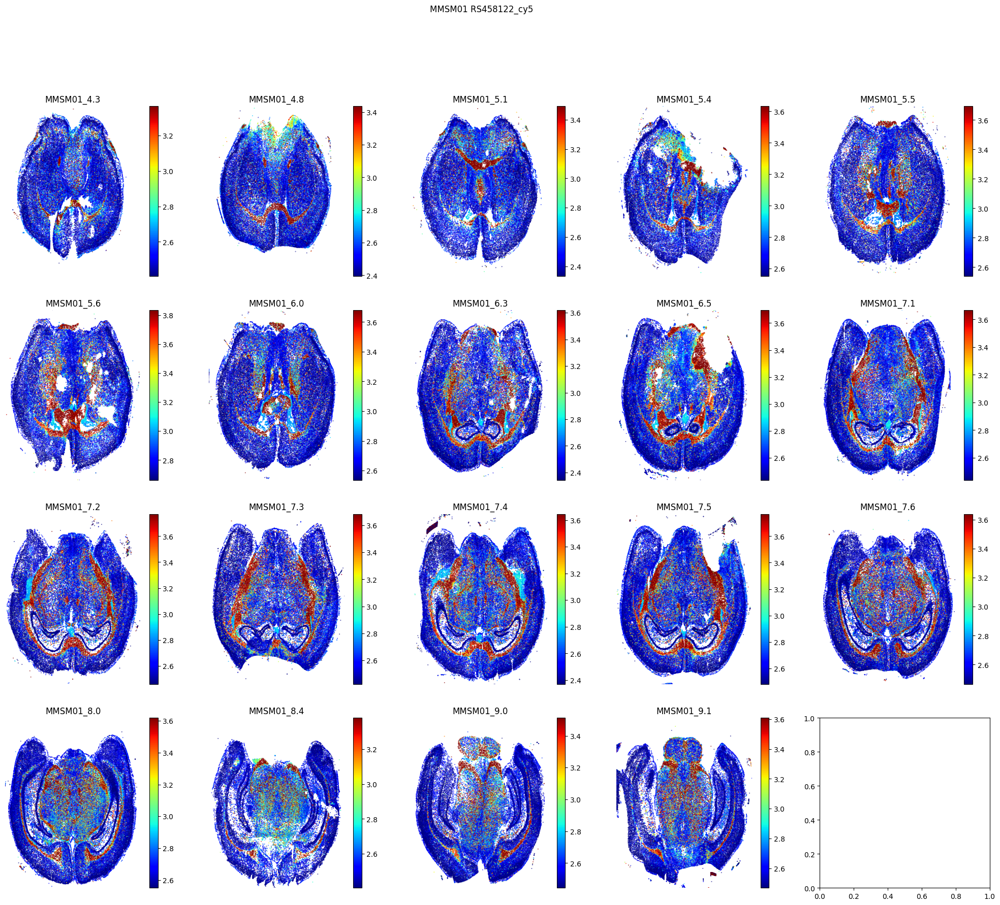

In [3]:
from dredFISH.Registration.Registration import *
from tqdm import tqdm
dataset_path = '/orangedata/Images2024/Zach/MouseBrainAtlas/'
dataset = 'MMSM01_1.1.A_2.1.B_3.1.C_4.1.F_5.1.E_6.1.D_2024Apr15'
processing_name = 'Processing_2024Apr19'
registration_name = 'Registration_2024Apr23'
registration_path = os.path.join(dataset_path,dataset,registration_name)
sections = [i for i in os.listdir(os.path.join(dataset_path,dataset,processing_name)) if 'Section' in i]
data_dict = {}
for section in tqdm(sections):
    if section in []:
        continue
    data = fileu.load(os.path.join(dataset_path,dataset,processing_name,section),file_type='anndata')
    if not isinstance(data,type(None)):
        try:
            XYZC  = Registration_Class(data.copy(),registration_path,section,verbose=False).run()
            data.obs['ccf_x'] = XYZC['ccf_x']
            data.obs['ccf_y'] = XYZC['ccf_y']
            data.obs['ccf_z'] = XYZC['ccf_z']
            """ Rename Section """
            section = f"{dataset.split('_')[0]}_{round(data.obs['ccf_x'].mean(),1)}"
            data_dict[section] = data
        except Exception as e:
            print(section)
            print(e)
n_columns = 4
n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
fig.suptitle(f"{dataset.split('_')[0]}")
axs = axs.ravel()
for i,section in enumerate(sorted(list(data_dict.keys()))):
    data = data_dict[section]
    ax = axs[i]
    ax.set_title(section)
    ax.axis('off')
    i+=1
    if not isinstance(data,type(None)):
        ax.scatter(data.obs['ccf_z'],data.obs['ccf_y'],c=data.obs['louvain_colors'],s=0.1)
    ax.set_xlim([-5.5,5.5])
    ax.set_ylim([0,8])
plt.show()

# n_columns = 4
# n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
# fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
# fig.suptitle(f"{dataset.split('_')[0]}")
# axs = axs.ravel()
# for i,section in enumerate(sorted(list(data_dict.keys()))):
#     data = data_dict[section]
#     ax = axs[i]
#     ax.set_title(section)
#     ax.axis('off')
#     i+=1
#     if not isinstance(data,type(None)):
#         ax.scatter(data.obs['stage_x'],data.obs['stage_y'],c=data.obs['louvain_colors'],s=0.1)
# plt.show()

from dredFISH.Utils import basicu
bit = 'RS0332_cy5'
n_columns = 4
n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
fig.suptitle(f"{dataset.split('_')[0]} {bit}")
axs = axs.ravel()
for i,section in enumerate(sorted(list(data_dict.keys()))):
    data = data_dict[section]
    X = data.layers['processed_vectors'].copy()
    X = np.log10(np.clip(X,1,None))
    X = basicu.normalize_fishdata_robust_regression(X)
    c = X[:,data.var.index==bit]
    vmin,vmax = np.percentile(c,[5,95])
    # vmin = 2.4
    # vmax=2.8
    c = np.clip(c,vmin,vmax)
    ax = axs[i]
    ax.set_title(section)
    ax.axis('off')
    im = ax.scatter(data.obs['ccf_z'],data.obs['ccf_y'],c=c,s=0.1,cmap='jet')
    plt.colorbar(im,ax=ax)
    ax.set_xlim([-5.5,5.5])
    ax.set_ylim([0,8])
plt.show()

from dredFISH.Utils import basicu
bit = 'RS458122_cy5'
n_columns = 4
n_rows = math.ceil(len(list(data_dict.keys()))/n_columns)
fig,axs = plt.subplots(n_columns,n_rows,figsize=[n_rows*5,n_columns*5])
fig.suptitle(f"{dataset.split('_')[0]} {bit}")
axs = axs.ravel()
for i,section in enumerate(sorted(list(data_dict.keys()))):
    data = data_dict[section]
    X = data.layers['processed_vectors'].copy()
    X = np.log10(np.clip(X,1,None))
    X = basicu.normalize_fishdata_robust_regression(X)
    c = X[:,data.var.index==bit]
    vmin,vmax = np.percentile(c,[5,95])
    # vmin = 2.4
    # vmax=2.8
    c = np.clip(c,vmin,vmax)
    ax = axs[i]
    ax.set_title(section)
    ax.axis('off')
    im = ax.scatter(data.obs['ccf_z'],data.obs['ccf_y'],c=c,s=0.1,cmap='jet')
    plt.colorbar(im,ax=ax)
    ax.set_xlim([-5.5,5.5])
    ax.set_ylim([0,8])
plt.show()